In [1]:
import sys
if not '..' in sys.path:
    sys.path.append('..')
import numpy as np
from matplotlib import pyplot as plt
from matplotlib import colormaps
from analysis import collection, analysis, emg
from analysis import plot as analysis_plot
import scipy as sp
import pandas as pd
from sklearn.mixture import BayesianGaussianMixture
from sklearn.base import clone
import seaborn as sns
import pickle
from scipy.stats import multivariate_normal
%matplotlib inline

projection into 2d:

$$ x \propto N(\mu, \Sigma) $$
$$ y = Ax + b $$
$$ y \propto N(A\mu + b, A\Sigma A^T) $$

[array([23,  1]), array([21,  4]), array([ 7, 19]), array([17, 23]), array([ 5, 24]), array([16, 11]), array([ 4, 15]), array([14,  5]), array([0, 6]), array([8, 7]), array([ 9, 13]), array([11,  9]), array([24, 17]), array([13, 18]), array([20, 22]), array([19, 10]), array([ 6, 12]), array([15, 14]), array([18,  3]), array([ 3, 21]), array([12,  2]), array([10, 16]), array([22,  0]), array([ 1, 20]), array([2, 8])]


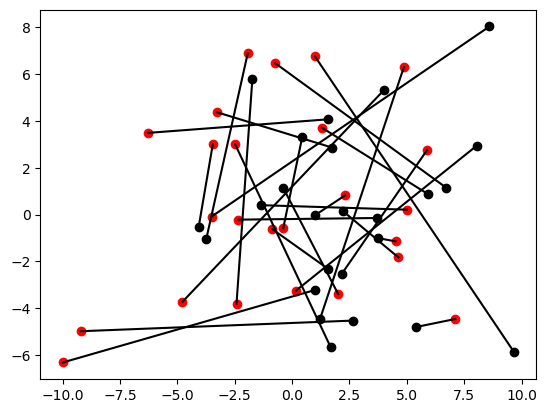

In [2]:
from matplotlib.patches import Ellipse
import matplotlib.transforms as transforms

def confidence_ellipse(center, cov, ax, n_std=3.0, edgecolor="k", facecolor='none', **kwargs):
    pearson = cov[0, 1] / np.sqrt(cov[0, 0] * cov[1, 1])
    # Using a special case to obtain the eigenvalues of this
    # two-dimensionl dataset.
    ell_radius_x = np.sqrt(1 + pearson)
    ell_radius_y = np.sqrt(1 - pearson)
    ellipse = Ellipse((0, 0),
        width=ell_radius_x * 2,
        height=ell_radius_y * 2,
        facecolor=facecolor,
        edgecolor=edgecolor,
        **kwargs)
    # Calculating the stdandard deviation of x from
    # the squareroot of the variance and multiplying
    # with the given number of standard deviations.
    scale_x = np.sqrt(cov[0, 0]) * n_std

    # calculating the stdandard deviation of y ...
    scale_y = np.sqrt(cov[1, 1]) * n_std

    transf = transforms.Affine2D() \
        .rotate_deg(45) \
        .scale(scale_x, scale_y) \
        .translate(center[0], center[1])

    ellipse.set_transform(transf + ax.transData)
    return ax.add_patch(ellipse)


def closest_pairs(points1, points2):
    # assert points1.shape[0] > points1.shape[1]
    # assert points2.shape[0] > points2.shape[1]
    # distances between 1 and 2
    distance_matrix = sp.spatial.distance.cdist(points1, points2)
    # indexes for rows and columns
    i1, i2 = np.indices((points1.shape[0],points2.shape[0]))
    # pair the indexes [row,col],[row,col], ...
    index_pairs = np.column_stack([i1.reshape(-1),i2.reshape(-1)])
    # flatten distance matrix the same way as indexes
    distances = distance_matrix.reshape(-1)
    # sort distances
    sorted_distance_indices = np.argsort(distances)
    stored_pairs = []
    used_pairs_1 = []
    used_pairs_2 = []
    # for every pairwise distance, shortest to longest
    for _, pair_idx in enumerate(sorted_distance_indices):
        # grab the original index pair to know which points
        pair = index_pairs[pair_idx]
        # check if we've seen either of these points before
        if (not pair[0] in used_pairs_1) and (not pair[1] in used_pairs_2):
            # if we haven't, store them
            stored_pairs.append(pair)
            used_pairs_1.append(pair[0])
            used_pairs_2.append(pair[1])
    return stored_pairs


# visual test
df1 = np.random.uniform(-1,1,(25,64))
df2 = np.random.uniform(-1,1,(25,64))
pairs = closest_pairs(df1,df2)
print(pairs)
test_decoder = np.random.normal(size=(2,64))
tdf1 = (test_decoder @ df1.T).T
tdf2 = (test_decoder @ df2.T).T
for p1, p2 in zip(tdf1, tdf2):
    plt.plot(p1[0],p1[1],"ro")
    plt.plot(p2[0],p2[1],"ko")
for pair in pairs:
    plt.plot([tdf1[pair[0]][0],tdf2[pair[1]][0]],[tdf1[pair[0]][1],tdf2[pair[1]][1]],"k-")

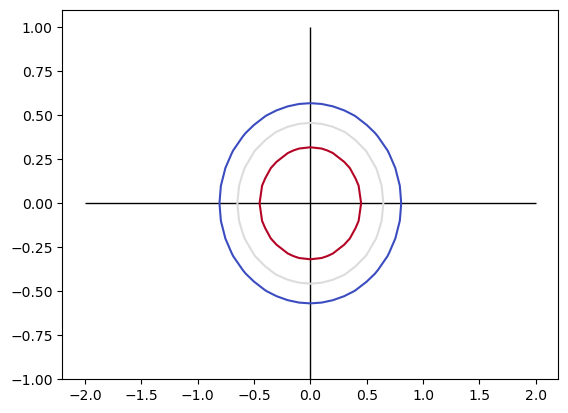

In [3]:
def transform_mean(decoder, mean):
    return decoder @ mean

def transform_covariance(decoder, covariance):
    return decoder @ covariance @ decoder.T

def plot_gaussian(mean, covariance, ax=None, xlims=None,ylims=None):
    if xlims is None:
        xlims = [-1,1]
    if ylims is None:
        ylims = [-1,1]
    x, y = np.mgrid[xlims[0]:xlims[1]:.1, ylims[0]:ylims[1]:.1]
    rv = multivariate_normal(mean, covariance)
    data = np.dstack((x, y))
    z = rv.pdf(data)
    zmax = z.max()
    if ax is None:
        fig, ax = plt.subplots(1,1)
    ax.contour(x, y, z,[zmax*0.85,zmax*0.9,zmax*0.95],cmap='coolwarm')

def plot_eigs(mean,covariance,ax=None,color="k",**kwargs):
    assert covariance.shape == (2,2)
    evals, evecs = np.linalg.eig(covariance)
    if ax is None:
        _, ax = plt.subplots(1,1)
    ax.arrow(mean[0],mean[1],evals[0]*evecs[0,0],evals[0]*evecs[1,0],head_width=0.0,color=color,**kwargs)
    ax.arrow(mean[0],mean[1],evals[1]*evecs[0,1],evals[1]*evecs[1,1],head_width=0.0,color=color,**kwargs)
    ax.arrow(mean[0],mean[1],-evals[0]*evecs[0,0],-evals[0]*evecs[1,0],head_width=0.0,color=color,**kwargs)
    ax.arrow(mean[0],mean[1],-evals[1]*evecs[0,1],-evals[1]*evecs[1,1],head_width=0.0,color=color,**kwargs)

# test
fig, ax = plt.subplots(1,1)
c = np.array([[2,0],[0,1]])
m = np.zeros(2)
plot_eigs(m,c,ax=ax)
plot_gaussian(np.zeros(2),c,xlims=[-1,1],ylims=[-1,1],ax=ax)

In [4]:
# insensitive to magnitude, "directional"
def cosine_distance(A,B):
    return 1 - (np.trace(np.dot(A,B)) / (np.linalg.norm(A,ord='fro') * np.linalg.norm(B,ord='fro')))

# sensitive to magnitudes
def frobenius_difference(A,B):
    return np.linalg.norm(A-B,ord='fro')

A = np.eye(10)
B = np.fliplr(np.eye(10))
cosine_distance(A,B), frobenius_difference(A,B)

(1.0, 4.47213595499958)

In [5]:
def make_lognormal_mean(normal_mean, normal_covariance):
    dim = normal_mean.shape[0]
    assert dim >= normal_mean.shape[1]
    assert dim == normal_covariance.shape[0] and dim == normal_covariance.shape[1]
    return np.exp(normal_mean + 0.5*np.diag(normal_covariance).reshape(-1,1))

def make_lognormal_covariance(normal_mean,normal_covariance):
    dim = normal_mean.shape[0]
    assert dim >= normal_mean.shape[1]
    assert dim == normal_covariance.shape[0] and dim == normal_covariance.shape[1]
    cov = np.zeros(shape=(dim,dim))
    cov[:] = np.nan
    for i in range(dim):
        for j in range(dim):
            cov[i,j] = (np.exp(normal_mean[i] + normal_mean[j] + 0.5*(normal_covariance[i,i] + normal_covariance[j,j]))*(np.exp(normal_covariance[i,j]) - 1)).reshape(-1)[0]
    assert np.all(np.isfinite(cov))
    return cov

In [6]:
def subject_hits_per_target(subject):
    target_hits = np.zeros(shape=(12))
    sessions = subject.tasks["center_hold"].sorted_sessions()
    for target_no in range(1,13):
        target_hit_count = 0
        for session in sessions:
            for trial in session.sorted_trials():
                if target_no == trial.target_number and trial.outcome == "Hit":
                    target_hit_count += 1
        target_hits[target_no-1] = target_hit_count
    return target_hits

In [7]:
from matplotlib.markers import MarkerStyle

def plot_weighted_targets(ax, weights):
    m = MarkerStyle("o", fillstyle="none")
    theta = (np.linspace(0, 2 * np.pi, 13) + np.pi)[:-1]
    for t, w in zip(theta, weights):
        ax.plot(
            np.cos(t),
            np.sin(t),
            marker=m,
            markersize=np.exp(w*30),
            color="grey",
        )

In [8]:
with open('olympics_subjects.pkl', 'rb') as handle:
    subjects = pickle.load(handle)
len(subjects)

46

In [9]:
reward_df = pd.read_pickle("trajectory_dataframe.pkl")
mean_rewards = reward_df.groupby(level=["subject"]).mean()["reward"]**-1
mean_rewards.shape

(46,)

In [10]:
subject_hits = []
for subject in subjects:
    hits = 0
    for s in subject.tasks["center_hold"].sorted_sessions():
        for t in s.sorted_trials():
            if t.outcome == "Hit":
                hits += 1
    subject_hits.append(hits)
hit_fractions = [sh/540 for sh in subject_hits]

In [11]:
def get_subject_target_hits(subject_idx):
    target_hits = np.zeros(shape=(12))
    sessions = subjects[subject_idx].tasks["center_hold"].sorted_sessions()
    for target_no in range(1,13):
        target_hit_count = 0
        for session in sessions:
            for trial in session.sorted_trials():
                if target_no == trial.target_number and trial.outcome == "Hit":
                    target_hit_count += 1
        target_hits[target_no-1] = target_hit_count
    return target_hits

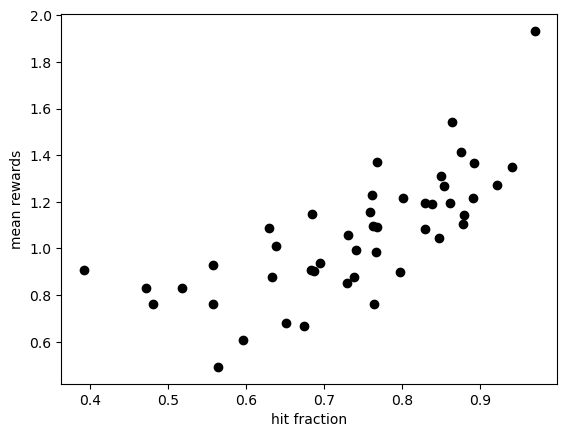

In [12]:
plt.plot(hit_fractions, mean_rewards,'ko')
plt.xlabel("hit fraction")
plt.ylabel("mean rewards")
plt.show()

In [13]:
def load_trial_stacks(subject_idx):
    return np.load(f"filtered_stacks/filtered_stack_{subject_idx}.npy")

In [31]:
def load_log_trial_models(subject_idx):
    with open(f"gmm_models_log_trial/subject_{subject_idx}.pkl","rb") as handle:
        return pickle.load(handle)

def load_trial_models(subject_idx):
    with open(f"gmm_models_trial/subject_{subject_idx}.pkl","rb") as handle:
        return pickle.load(handle)
    
def load_log_calibration_models(subject_idx):
    with open(f"gmm_models_log_calibration/subject_{subject_idx}.pkl","rb") as handle:
        return pickle.load(handle)
    
def load_log_movement_models(subject_idx):
    with open(f"gmm_models_log_movement/subject_{subject_idx}.pkl","rb") as handle:
        return pickle.load(handle)

In [15]:
def zero_ch_56_mean(mean):
    mean = mean.copy()
    mean[56,0] = 0
    return mean

def zero_ch_56_cov(cov):
    cov = cov.copy()
    cov[:,56] = 0
    cov[56,:] = 0
    return cov

In [16]:
def log_emg_data(samples):
    assert len(samples.shape) == 2
    assert samples.shape[0] > samples.shape[1]
    samples[:,56] = np.mean(samples[:,(56-8,56-16)],axis=1)
    return np.log(samples)

### compare log-data cov and covs of model  

(64, 48959)
(64, 1) (64, 64)


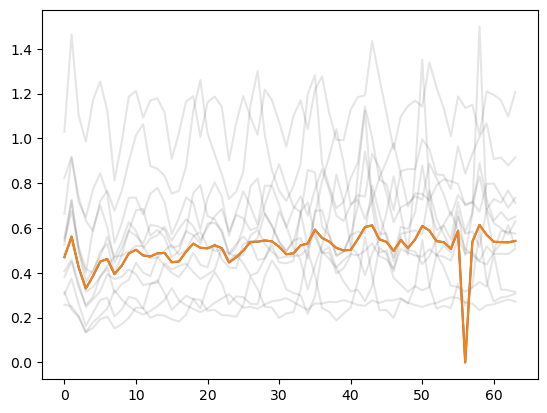

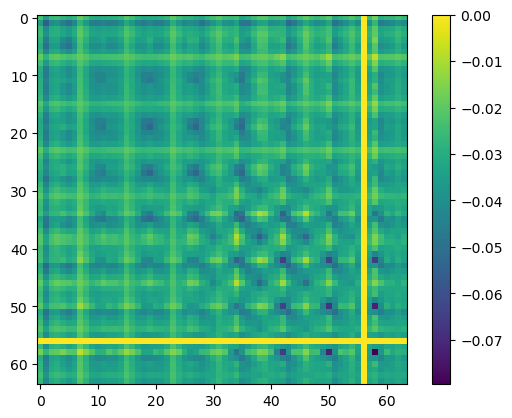

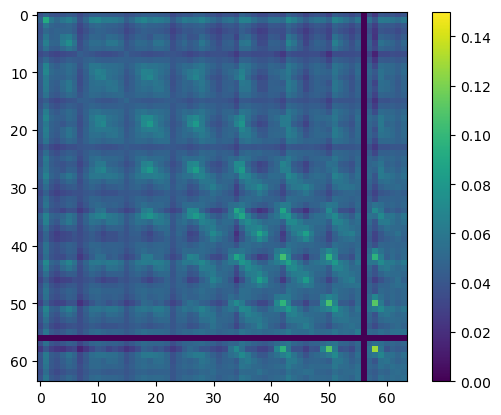

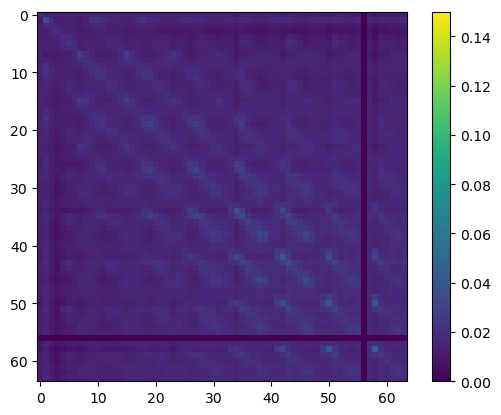

In [49]:
subject_idx = 12
# get the first chunk
first_chunk = analysis.remove_nan_rows(load_trial_stacks(subject_idx).transpose(0,1,3,2)[:9].reshape(-1,64)).T
print(first_chunk.shape)
empirical_cov = np.cov(first_chunk)
empirical_mean = np.mean(first_chunk,axis=1).reshape(-1,1)
print(empirical_mean.shape, empirical_cov.shape)

first_model = load_trial_models(subject_idx)[0]

cov_sum = np.zeros(shape=(64,64))
mean_sum = np.zeros(shape=(64,))
plt.figure()
for cov, mean, weight in zip(first_model.covariances_, first_model.means_, first_model.weights_):
    # plt.figure()
    # plt.imshow(cov)
    plt.plot(mean,"k",alpha=0.1)
    cov_sum += weight*cov 
    mean_sum += weight*mean

plt.plot(empirical_mean)
plt.plot(zero_ch_56_mean(mean_sum.reshape(-1,1)))

plt.figure()
plt.imshow(zero_ch_56_cov(cov_sum) - empirical_cov)
plt.colorbar()

plt.figure()
plt.imshow(empirical_cov,vmin=0,vmax=0.15)
plt.colorbar()

plt.figure()
plt.imshow(zero_ch_56_cov(cov_sum),vmin=0,vmax=0.15)
plt.colorbar()


/tmp/ipykernel_54046/2309397818.py:7: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "ko" (-> marker='o'). The keyword argument will take precedence.
  ax.plot(
/tmp/ipykernel_54046/2309397818.py:7: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ko" (-> color='k'). The keyword argument will take precedence.
  ax.plot(


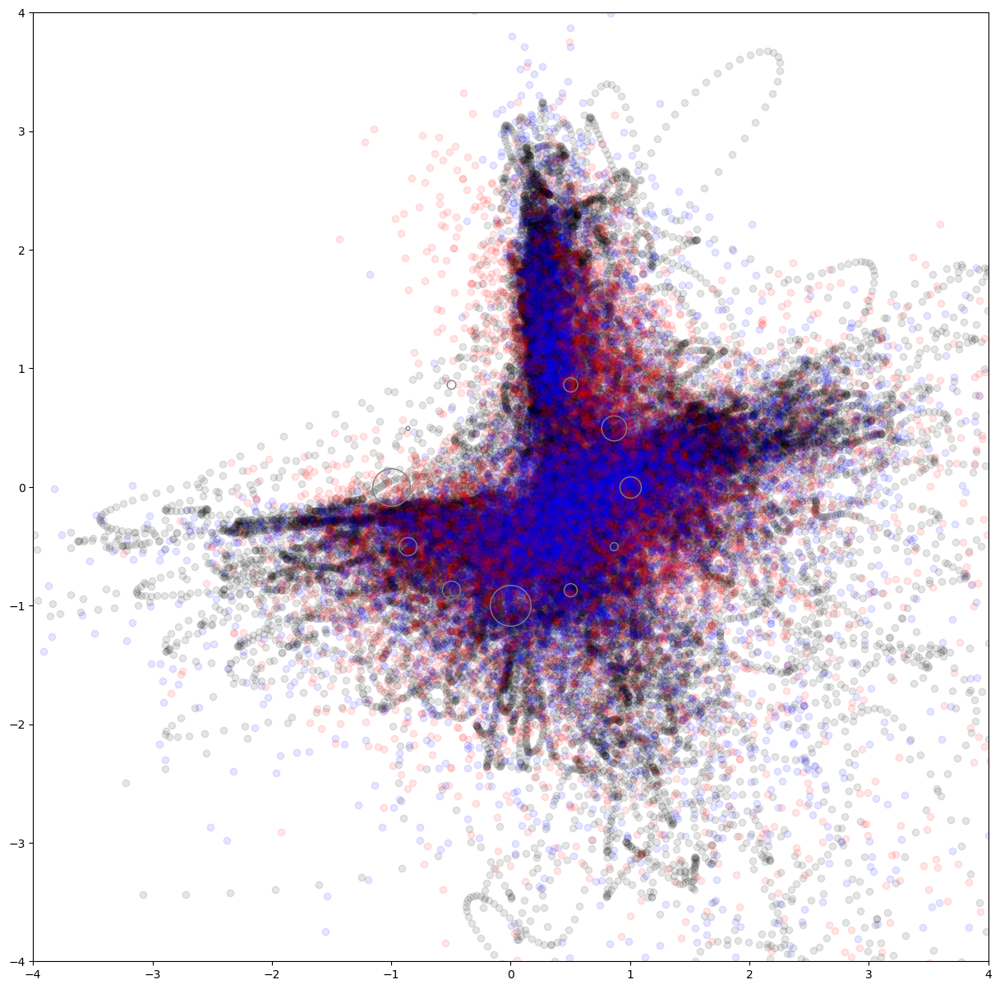

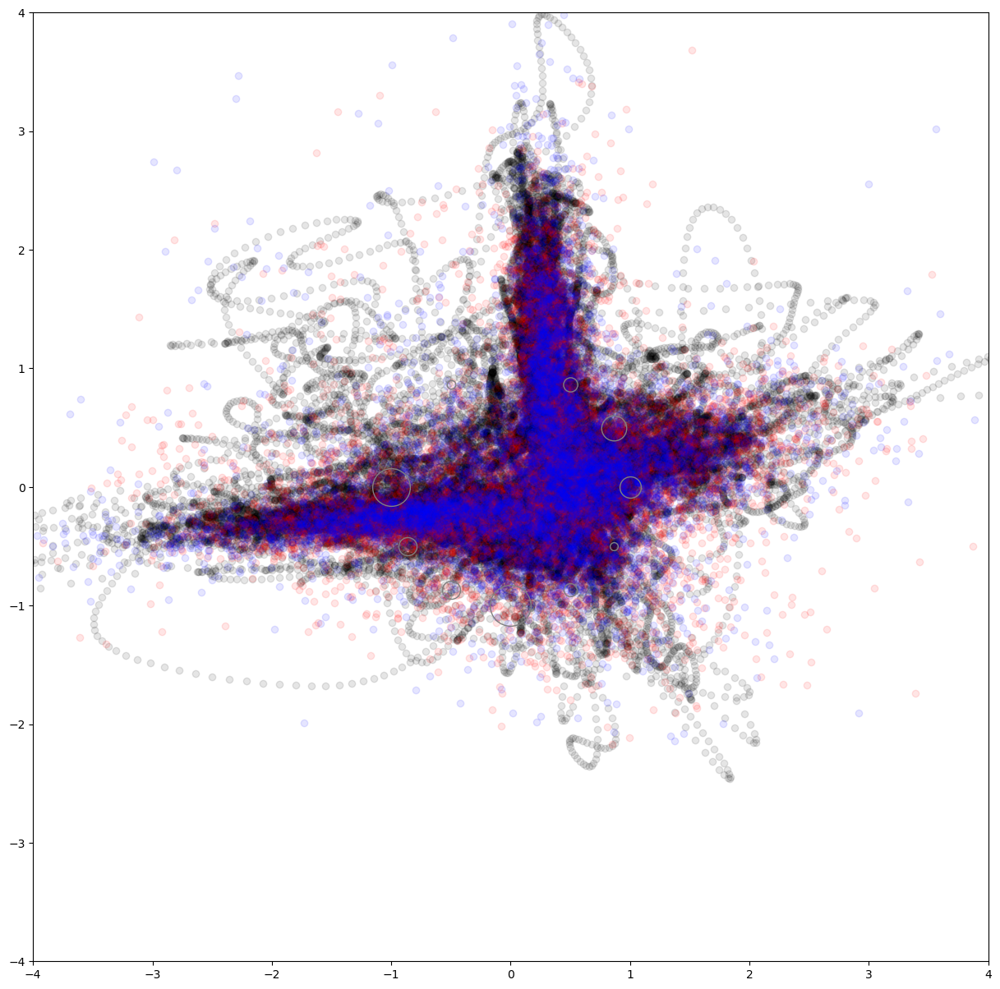

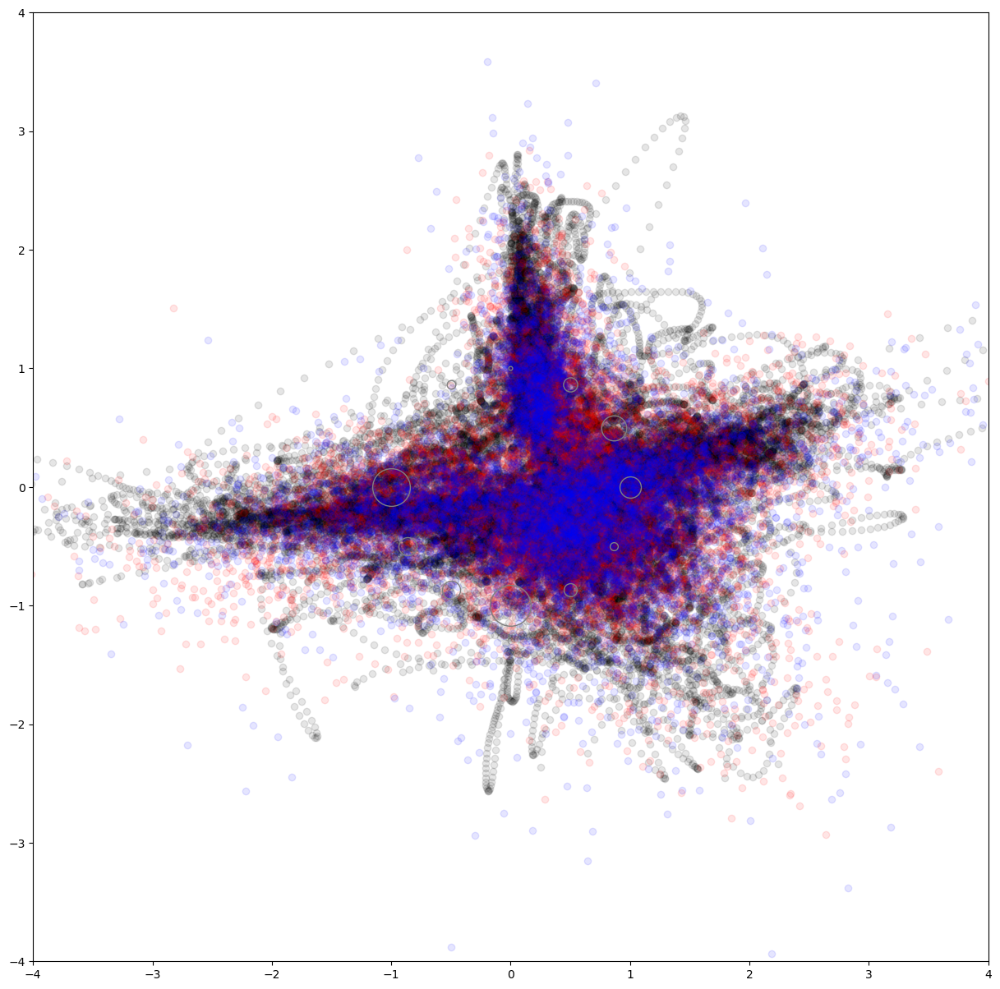

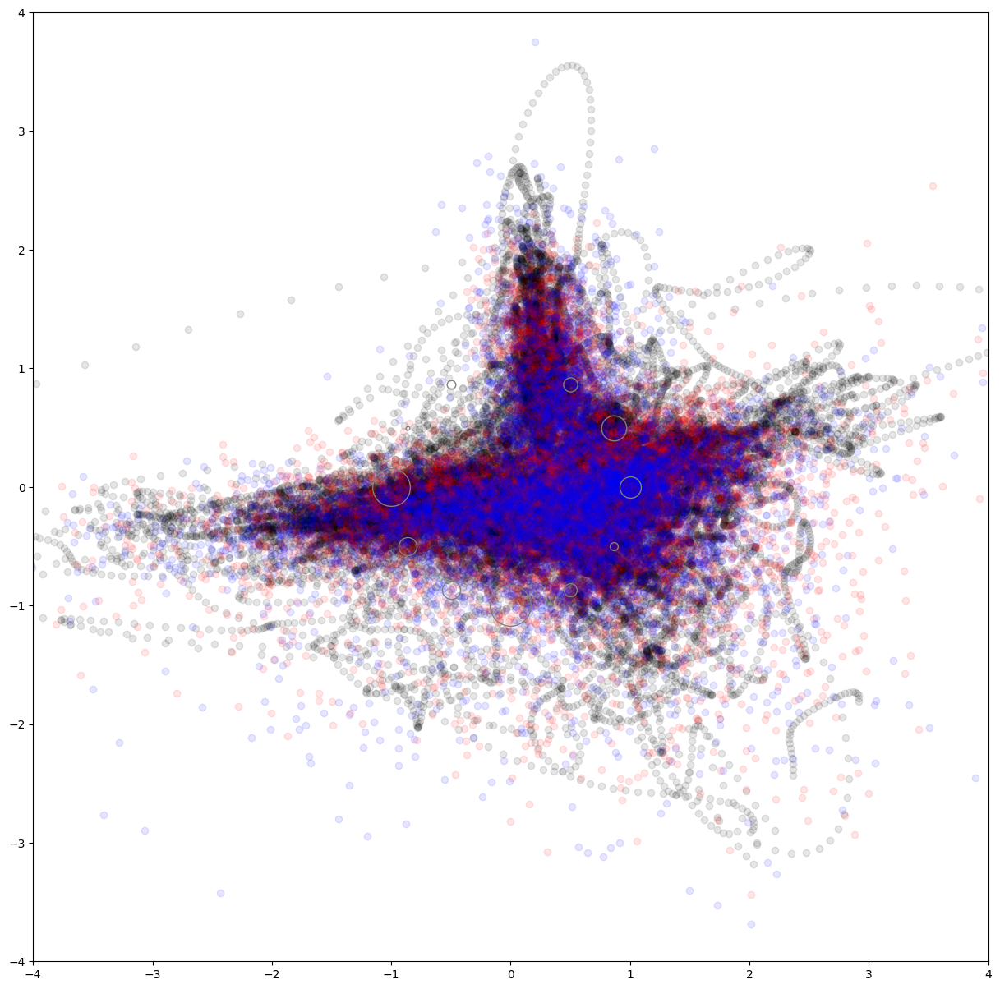

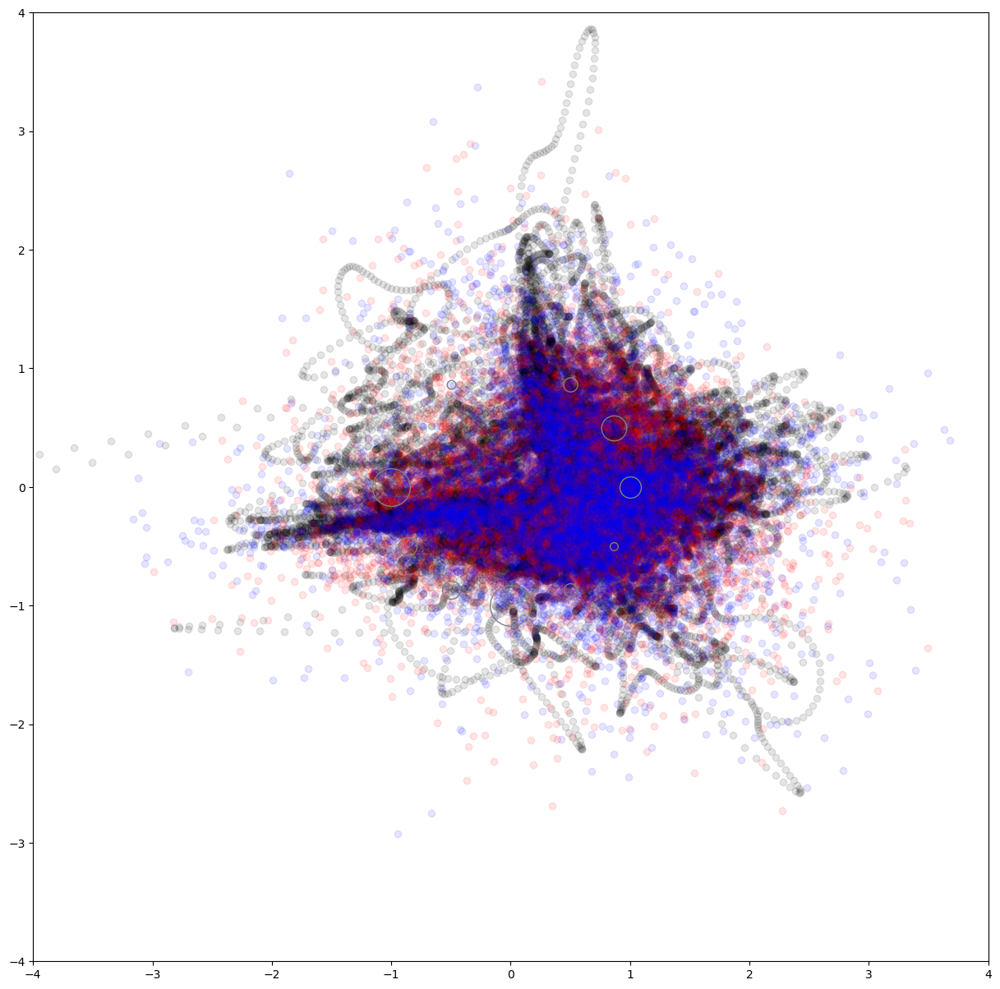

In [104]:
subject_idx = 5
decoder = subjects[subject_idx].decoder[-2:,:]
block_chunks = [(i,j) for i,j in zip(range(0,45+1,9)[:-1],range(0,45+1,9)[1:])]
for i, b in enumerate(block_chunks):
    plt.figure(figsize=(15,15))
    chunk = decoder @ analysis.remove_nan_rows(load_trial_stacks(subject_idx).transpose(0,1,3,2)[b[0]:b[1]].reshape(-1,64)).T
    model = load_trial_models(subject_idx)[i]
    log_model = load_log_trial_models(subject_idx)[i]

    samples = decoder @ model.sample(200*9*5)[0].T
    log_samples = decoder @ np.exp(log_model.sample(200*9*5)[0].T)

    plt.plot(chunk[0], chunk[1],"ko",alpha=0.1)
    plt.plot(samples[0], samples[1],"ro",alpha=0.1)
    plt.plot(log_samples[0], log_samples[1],"bo",alpha=0.1)
    plot_weighted_targets(plt.gca(),get_subject_target_hits(subject_idx)/get_subject_target_hits(subject_idx).sum())
    plt.ylim([-4,4])
    plt.xlim([-4,4])

/tmp/ipykernel_41011/2878047785.py:3: RuntimeWarning: invalid value encountered in log
  return np.log(samples)


(64, 1) (64, 64)


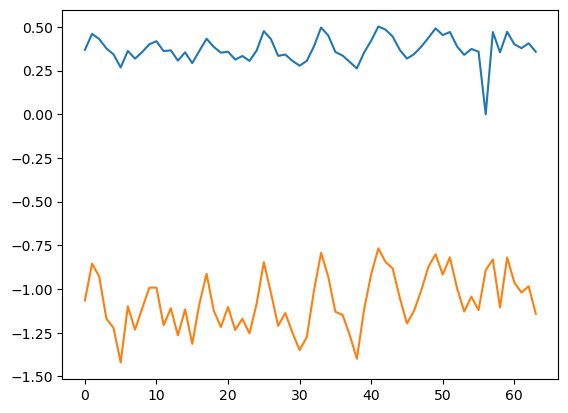

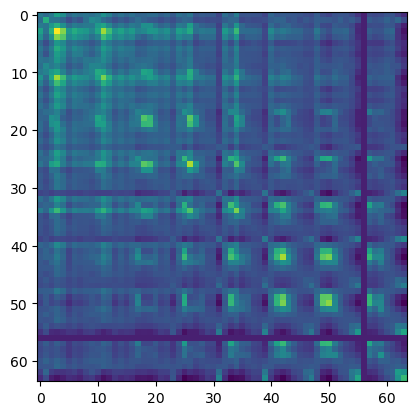

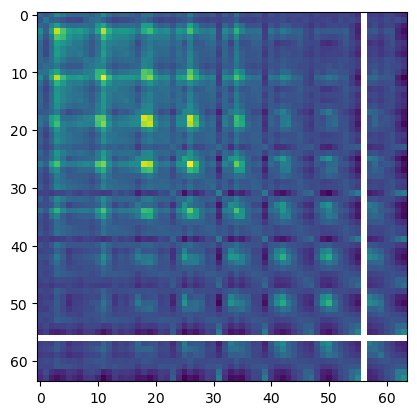

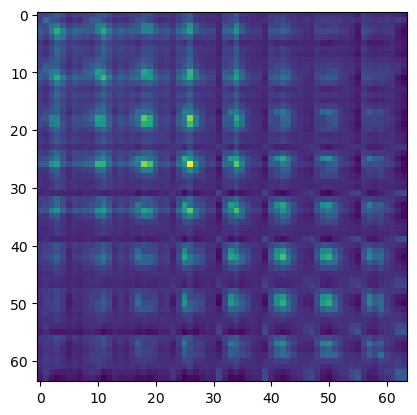

In [51]:
plt.plot(np.mean(analysis.remove_nan_rows(load_trial_stacks(6).transpose(0,1,3,2).reshape(-1,64)).T,axis=1))
plt.plot(np.mean(log_emg_data(analysis.remove_nan_rows(load_trial_stacks(6).transpose(0,1,3,2).reshape(-1,64))).T,axis=1))

plt.figure()
plt.imshow(np.cov(analysis.remove_nan_rows(load_trial_stacks(6).transpose(0,1,3,2).reshape(-1,64)).T))

plt.figure()
plt.imshow(np.cov(log_emg_data(analysis.remove_nan_rows(load_trial_stacks(6).transpose(0,1,3,2).reshape(-1,64)).T)))

m = np.mean(log_emg_data(analysis.remove_nan_rows(load_trial_stacks(6).transpose(0,1,3,2).reshape(-1,64))).T,axis=1).reshape(-1,1)
c = np.cov(log_emg_data(analysis.remove_nan_rows(load_trial_stacks(6).transpose(0,1,3,2).reshape(-1,64))).T)
print(m.shape, c.shape)
plt.figure()
plt.imshow(make_lognormal_covariance(m,c))

/tmp/ipykernel_54046/2309397818.py:7: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "ko" (-> marker='o'). The keyword argument will take precedence.
  ax.plot(
/tmp/ipykernel_54046/2309397818.py:7: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ko" (-> color='k'). The keyword argument will take precedence.
  ax.plot(


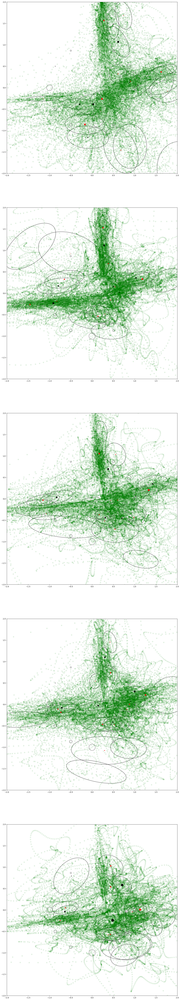

In [105]:
subject_idx = 5

block_chunks = [(i,j) for i,j in zip(range(0,45+1,9)[:-1],range(0,45+1,9)[1:])]

stack = load_trial_stacks(subject_idx).transpose(0,1,3,2)

fig, model_axes = plt.subplots(5,1,figsize=(20,100))
c = ["r","b","g","c","m"]
model_axes = model_axes.ravel()

subject_log_models = load_log_trial_models(subject_idx)
subject_models = load_trial_models(subject_idx)

decoder = subjects[subject_idx].decoder[-2:,:]
for i, (log_model, model) in enumerate(zip(subject_log_models, subject_models)):
    model_ax = model_axes[i]
    chunk_samples = decoder @ stack[block_chunks[i][0]:block_chunks[i][1]].reshape(-1,64).T
    model_ax.plot(chunk_samples[0],chunk_samples[1],"go",alpha=0.1)
    for mean, covariance, weight in zip(log_model.means_,log_model.covariances_,log_model.weights_):
        log_mean = make_lognormal_mean(mean.reshape(-1,1),covariance)
        log_cov = make_lognormal_covariance(mean.reshape(-1,1),covariance)
        log_mean = zero_ch_56_mean(log_mean.reshape(-1,1))
        log_cov = zero_ch_56_cov(log_cov)
        tm = transform_mean(decoder, log_mean)
        tc = transform_covariance(decoder, log_cov)
        model_ax.plot(tm[0],tm[1],'ro',zorder=100,markersize=weight*50)
        plot_weighted_targets(model_ax,get_subject_target_hits(subject_idx)/get_subject_target_hits(subject_idx).sum())
        confidence_ellipse(tm,tc,model_ax,n_std=0.5)
        model_ax.set_aspect("equal")
    for mean, covariance, weight in zip(model.means_,model.covariances_,model.weights_):
        mean = zero_ch_56_mean(mean.reshape(-1,1))
        cov = zero_ch_56_cov(covariance)
        tm = transform_mean(decoder, mean)
        tc = transform_covariance(decoder, cov)
        model_ax.plot(tm[0],tm[1],'ko',zorder=100,markersize=weight*50)
        confidence_ellipse(tm,tc,model_ax,n_std=0.5)
    model_ax.set_ylim([-2,2])
    model_ax.set_xlim([-2,2])

/tmp/ipykernel_54046/2309397818.py:7: UserWarning: marker is redundantly defined by the 'marker' keyword argument and the fmt string "ko" (-> marker='o'). The keyword argument will take precedence.
  ax.plot(
/tmp/ipykernel_54046/2309397818.py:7: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "ko" (-> color='k'). The keyword argument will take precedence.
  ax.plot(
/tmp/ipykernel_54046/3502102244.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, model_axes = plt.subplots(1,5,figsize=(50,10))


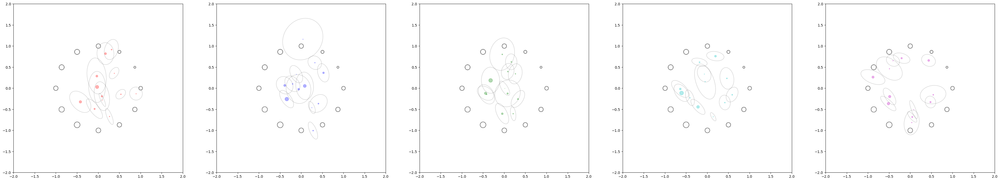

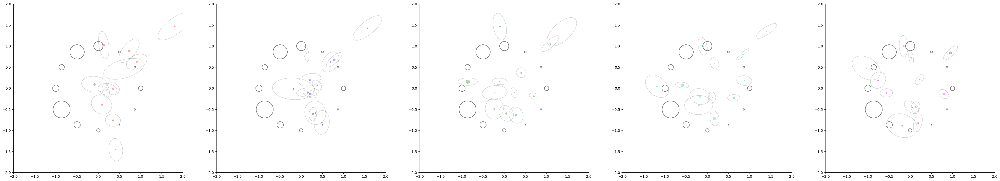

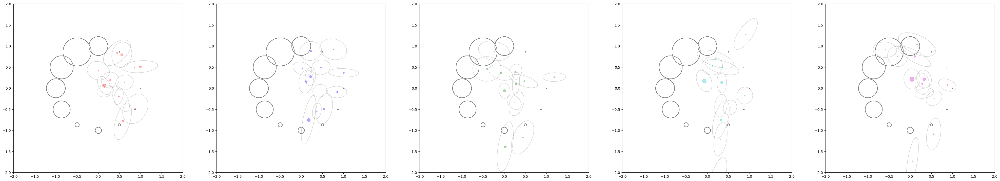

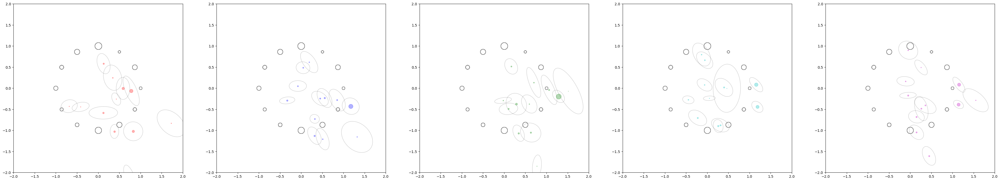

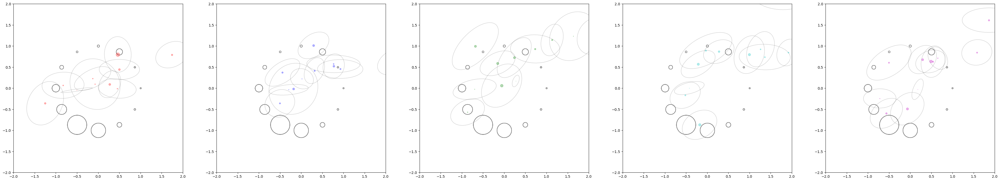

...

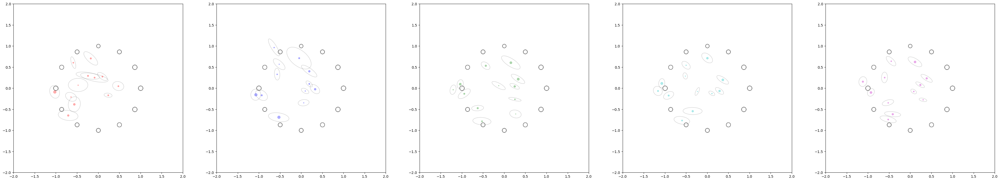

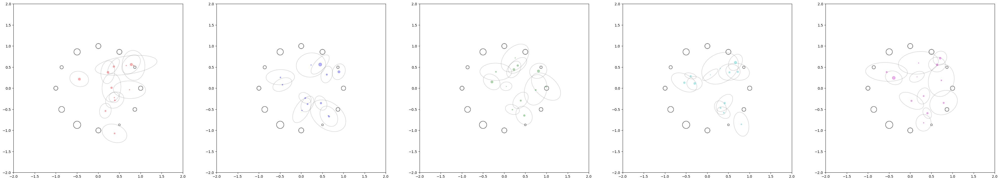

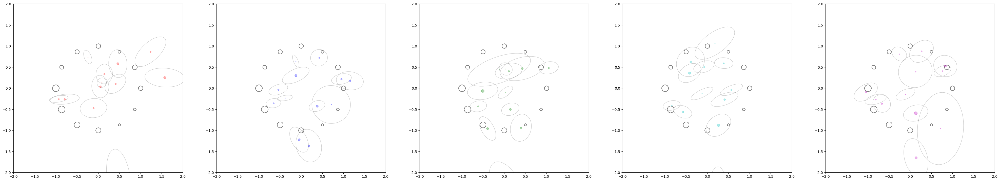

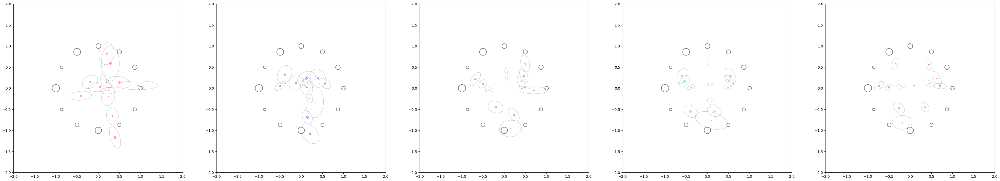

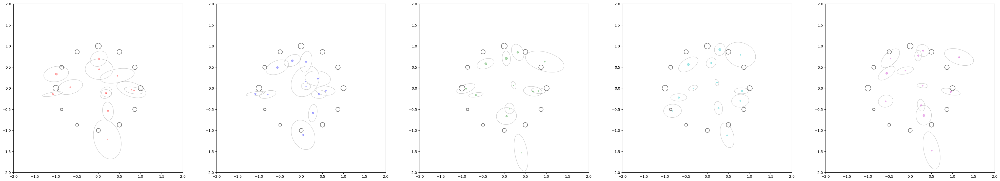

In [108]:
# subject_idx = 6
for subject_idx in range(34):
    fig, model_axes = plt.subplots(1,5,figsize=(50,10))
    c = ["r","b","g","c","m"]
    model_axes = model_axes.ravel()
    models = load_log_trial_models(subject_idx)
    decoder = subjects[subject_idx].decoder[-2:,:]
    for i, model in enumerate(models):
        model_ax = model_axes[i]
        for mean, covariance, weight in zip(model.means_,model.covariances_,model.weights_):
            log_mean = make_lognormal_mean(mean.reshape(-1,1),covariance)
            log_cov = make_lognormal_covariance(mean.reshape(-1,1),covariance)
            log_mean = zero_ch_56_mean(log_mean.reshape(-1,1))
            log_cov = zero_ch_56_cov(log_cov)
            tm = transform_mean(decoder, log_mean)
            tc = transform_covariance(decoder, log_cov)
            model_ax.plot(tm[0],tm[1],c[i]+'o',zorder=100,markersize=weight*50,alpha=0.3)
            plot_weighted_targets(model_ax,get_subject_target_hits(subject_idx)/get_subject_target_hits(subject_idx).sum())
            confidence_ellipse(tm,tc,model_ax,n_std=0.5,alpha=0.2)
        model_ax.set_ylim([-2,2])
        model_ax.set_xlim([-2,2])
        model_ax.set_aspect("equal")

In [17]:
class log_model():
    def __init__(self, model) -> None:
        self.means = np.array([zero_ch_56_mean(make_lognormal_mean(mean.reshape(-1,1), covariance)).reshape(-1) for mean, covariance in zip(model.means_, model.covariances_)])
        self.covariances = np.array([zero_ch_56_cov(make_lognormal_covariance(mean.reshape(-1,1), covariance)) for mean, covariance in zip(model.means_, model.covariances_)])
        self.weights = model.weights_

class model_2d():
    def __init__(self,model,decoder) -> None:
        self.means = np.array([transform_mean(decoder,mean) for mean in model.means])
        self.covariances = np.array([transform_covariance(decoder,cov) for cov in model.covariances])
        self.weights = model.weights

def compute_model_mean_pairs(models,mean_weight=1.0, weight_weight=0.0,cov_weight=0.0):
    model_mean_pairs = []
    for model_1, model_2 in zip(models[:-1],models[1:]):
        lower_tris1 =  np.array([cov[np.tril_indices(64)] for cov in model_1.covariances_])
        lower_tris2 =  np.array([cov[np.tril_indices(64)] for cov in model_2.covariances_])
        model_1_vec = np.concatenate([model_1.means_*mean_weight,lower_tris1*cov_weight,model_1.weights_.reshape(-1,1)*weight_weight],axis=1)
        model_2_vec = np.concatenate([model_2.means_*mean_weight,lower_tris2*cov_weight,model_2.weights_.reshape(-1,1)*weight_weight],axis=1)
        model_mean_pairs.append(closest_pairs(model_1_vec, model_2_vec))
    return np.array(model_mean_pairs)

<Figure size 1000x1000 with 0 Axes>

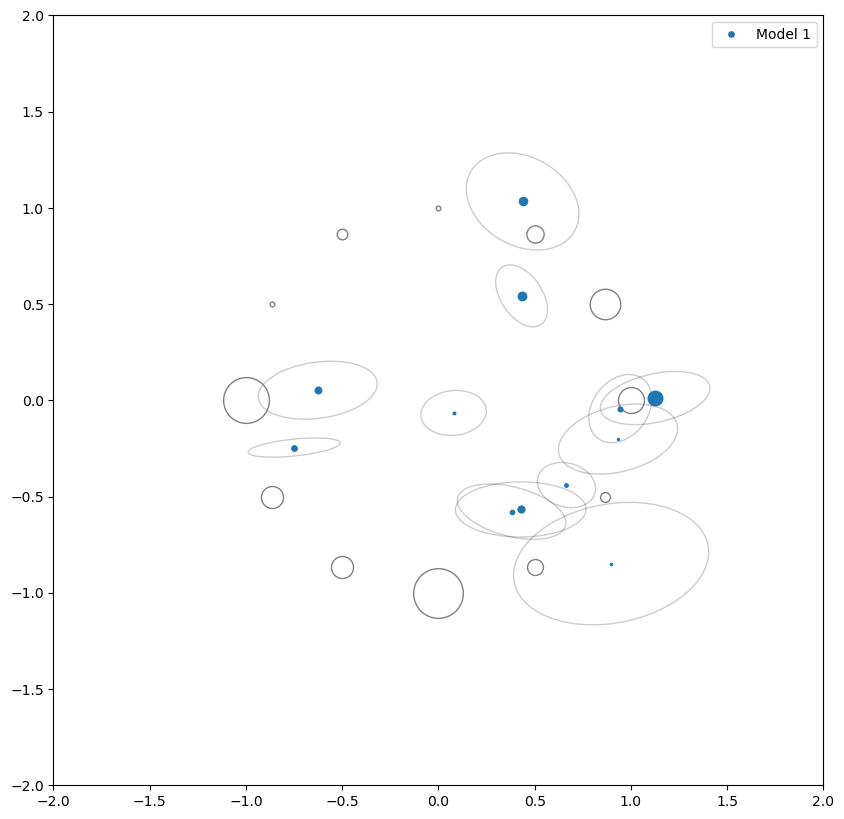

In [24]:
subject_idx = 5
models = load_log_trial_models(subject_idx)[-1:]
decoder = subjects[subject_idx].decoder[-2:,:]

plt.figure(figsize=(10,10))

# go back to lognormal space
log_models = []
for model in models:
    log_models.append(log_model(model))

models_2d = []
for model in log_models:
    models_2d.append(model_2d(model,decoder))

# use distances in log-transformed 64D space to track means
model_mean_pairs = compute_model_mean_pairs(models)

fig, model_ax = plt.subplots(1,1,figsize=(10,10))
model_ax.set_aspect("equal")

# plot the lines between the means
for model_idx, mean_pair in enumerate(model_mean_pairs):
    for i, component_pair in enumerate(mean_pair):
        # first model
        x1 = models_2d[model_idx].means[component_pair[0]][0]
        y1 = models_2d[model_idx].means[component_pair[0]][1]
        # second model
        x2 = models_2d[model_idx+1].means[component_pair[1]][0]
        y2 = models_2d[model_idx+1].means[component_pair[1]][1]

        h = model_ax.plot([x1,x2], [y1,y2],color="k")

# plot means and covariances
for i, model in enumerate(models_2d):
    for component_mean, component_covariance, component_weight in zip(model.means, model.covariances, model.weights):
        h = model_ax.plot(component_mean[0],component_mean[1],'o',zorder=100,color=colormaps["tab10"](i/len(models_2d)),markersize=component_weight*50)
        confidence_ellipse(component_mean,component_covariance,model_ax,n_std=0.5,alpha=0.2)
    h[0].set_label(f"Model {i+1}")
plot_weighted_targets(model_ax,get_subject_target_hits(subject_idx)/get_subject_target_hits(subject_idx).sum())
model_ax.set_ylim([-2,2])
model_ax.set_xlim([-2,2])
model_ax.legend()

## model covariance "derivatives"

In [27]:
def linear_fit(x_data, y_data):
    result = sp.stats.linregress(x_data, y_data)
    return result

def plot_linear_fit(x, result, ax):
    ax.plot(x, result.intercept + result.slope*x,"--", color="tab:red", label=f"Linear Fit, $R^2$={np.round(result.rvalue**2, 5)}")

In [48]:
subject_diffs = []
for subject_idx in range(len(subjects)):
    log_models = load_log_trial_models(subject_idx)
    models = []
    for model in log_models:
        models.append(log_model(model))
    model_diffs = []
    model_mean_pairs = compute_model_mean_pairs(log_models)
    for model_idx, mean_pair in enumerate(model_mean_pairs):
        component_diffs = []
        for i, component_pair in enumerate(mean_pair):
            # model x --> model y
            # paired components
            component_diffs.append(frobenius_difference(models[model_idx].covariances[component_pair[0]], models[model_idx+1].covariances[component_pair[1]]))
        model_diffs.append(component_diffs)
    subject_diffs.append(model_diffs)
    
diff_rewards = []
mean_diffs = []
for i, model_diffs in enumerate(subject_diffs):
    diff_rewards.append(mean_rewards[i])
    # mean of the differences between subsequent models
    mean_diffs.append(np.mean(model_diffs))

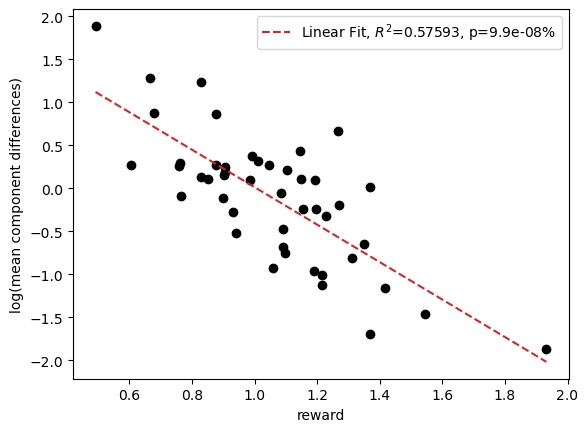

In [51]:
plt.figure()
plt.plot(diff_rewards,np.log(mean_diffs),"ko")
r = linear_fit(diff_rewards,np.log(mean_diffs))
x = np.linspace(np.min(diff_rewards),np.max(diff_rewards),100)
plt.gca().plot(x, (r.intercept + r.slope*x),"--", color="tab:red", label=f"Linear Fit, $R^2$={np.round(r.rvalue**2, 5)}, p={np.round(r.pvalue*100,9)}%")
plt.ylabel("log(mean component differences)")
plt.xlabel("reward")
plt.legend()

## reconstructed covariance check

In [ ]:
fig, axes = plt.subplots(6,6,figsize=(30,30))
for yaxi, si in enumerate(range(4)):
    model = subject_prior_models[si]
    cov_sum = np.zeros(shape=(64,64))
    for covi, (ax, cov) in enumerate(zip(axes[yaxi,:4].ravel(),model.covariances_)):
        ax.imshow(cov)
        ax.set_title(f"Component {covi}")
        cov_sum += model.weights_[covi]*cov
    data1 = subject_calibration_stacks[si].transpose((0,1,3,2)).reshape(-1,64)
    # data2 = subject_movement_stacks[si].transpose((0,1,3,2)).reshape(-1,64)
    # data = np.concatenate([data1,data2],axis=0)
    data = analysis.remove_nan_rows(data1)
    axes[yaxi,4].imshow(np.cov(data.T))
    axes[yaxi,4].set_title("Empirical Covariance")
    axes[yaxi,5].imshow(cov_sum)
    axes[yaxi,5].set_title("Reconstructed Covariance")

## "effective" rank of the component covariance -- subspace confinement

3.6678215659039556e-07


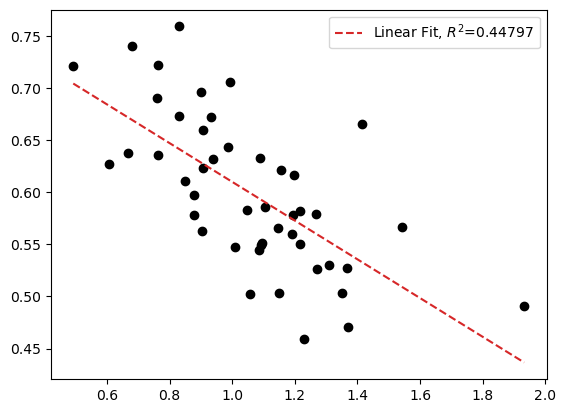

In [24]:
# subjects, model, component, singular vals
n_sing_vals = 1
s = np.zeros(shape=(46,5,12))
for subject_idx in range(len(subjects)):
    for i, model in enumerate(load_log_trial_models(subject_idx)):
        # each model over time
        for k, cov in enumerate(model.covariances_):
            # svd of each of the 4 components
            U, S, V = np.linalg.svd(cov)
            s[subject_idx,i,k] = (S[:n_sing_vals]/S.sum()).reshape(-1)[0]

mean_sv = np.mean(s,axis=(1,2))
plt.plot(mean_rewards,mean_sv,'ko')
res = linear_fit(mean_rewards, mean_sv)
x = np.linspace(mean_rewards.min(),mean_rewards.max(),100)
plot_linear_fit(x, res, plt.gca())
plt.legend()
plt.ylabel("Mean Effective Rank")
plt.xlabel("Mean Reward")
print(res.pvalue)

0.0347056537163735


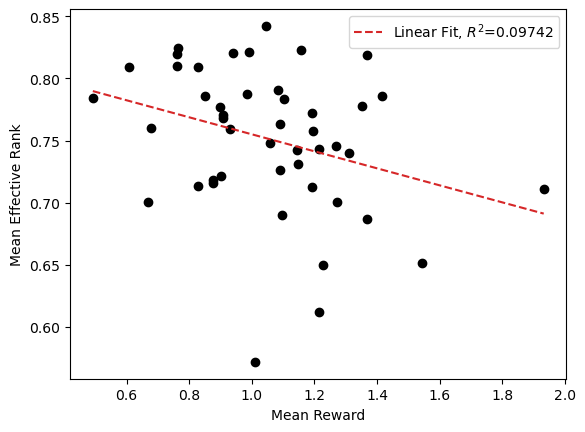

In [30]:
# subjects, model, component, singular vals
n_sing_vals = 1
s = np.zeros(shape=(46,1,12))
for subject_idx in range(len(subjects)):
    for i, model in enumerate(load_log_calibration_models(subject_idx)):
        # each model over time
        for k, cov in enumerate(model.covariances_):
            # svd of each of the 4 components
            U, S, V = np.linalg.svd(cov)
            s[subject_idx,i,k] = (S[:n_sing_vals]/S.sum()).reshape(-1)[0]

mean_sv = np.mean(s,axis=(1,2))
plt.plot(mean_rewards,mean_sv,'ko')
res = linear_fit(mean_rewards, mean_sv)
x = np.linspace(mean_rewards.min(),mean_rewards.max(),100)
plot_linear_fit(x, res, plt.gca())
plt.legend()
plt.ylabel("Mean Effective Rank")
plt.xlabel("Mean Reward")
print(res.pvalue)

0.527093669194812


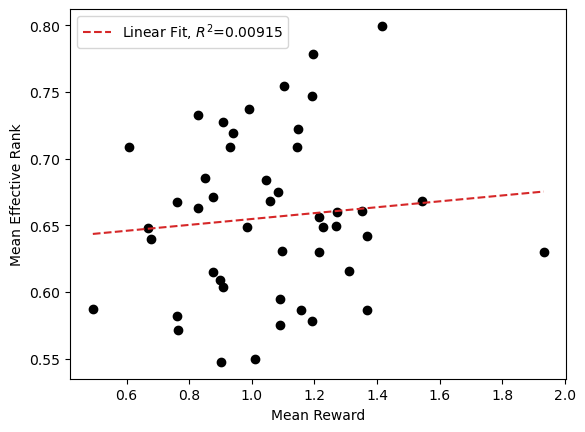

In [32]:
# subjects, model, component, singular vals
n_sing_vals = 1
s = np.zeros(shape=(46,1,12))
for subject_idx in range(len(subjects)):
    for i, model in enumerate(load_log_movement_models(subject_idx)):
        # each model over time
        for k, cov in enumerate(model.covariances_):
            # svd of each of the 4 components
            U, S, V = np.linalg.svd(cov)
            s[subject_idx,i,k] = (S[:n_sing_vals]/S.sum()).reshape(-1)[0]

mean_sv = np.mean(s,axis=(1,2))
plt.plot(mean_rewards,mean_sv,'ko')
res = linear_fit(mean_rewards, mean_sv)
x = np.linspace(mean_rewards.min(),mean_rewards.max(),100)
plot_linear_fit(x, res, plt.gca())
plt.legend()
plt.ylabel("Mean Effective Rank")
plt.xlabel("Mean Reward")
print(res.pvalue)

We expect more confinement will make it more difficult for subjects to reach targets.

We measure confinement by looking at the rank of individual covariance matrices.

### ^^ this points to subspace confinement being linked to performance -- higher performers tend to have more "spread" activity, or are less "subspace confined" -- this makes sense!

# what changes over the course of learning? 

Can we develop metrics across learning that show WHAT people are learning?

Our hint is that variance decreases over time-- we want to capture this succinctly, e.g. Sum(Tr(Cov))?

We know that we get this X-pattern because of subspace confinement, so we might expect subjects to unconfine themselves over the course of learning-- the top singular value would tend to decrease in variance over learning.

This needs to be relative to the subject's total variance? 

The correlation between performance and subspace confinment goes away over time-- subjects become less confined?

The activities become more self-similar over time-- the correlation/distance between subsequent models increases? the difference between subsequent models decreases? 